# AdaIN

Implementation of paper [Arbitrary Style Transfer in Real-time with Adaptive Instance Normalization](https://arxiv.org/pdf/1703.06868.pdf) using Tensorflow 1.x.
The dataset for content is [MS-COCO](http://cocodataset.org/#home) and the dataset for style is [wikiart](https://github.com/cs-chan/ArtGAN/tree/master/WikiArt%20Dataset)

Reference(AdaIN): https://github.com/ftokarev/tf-adain <br>
Reference(VGG): https://github.com/jiweibo/ImageNet

## Import Libraries

In [1]:
import torch
import torch.nn as nn
import torch.utils.model_zoo as model_zoo
import torch.optim as optim
import torch.utils.data
import torch.nn.functional as F

import data_loader

import numpy as np
import matplotlib.pyplot as plt 
import random 
import os 
import datetime 
import cv2

os.environ['CUDA_VISIBLE_DEVICES'] = '0'

## Parameters

In [2]:
algorithm = 'AdaIN'

resize_dim = 512 
crop_size = 256 

batch_size = 8
train_batch = 10000

alpha = 1.0
style_weight = 2.0
learning_rate = 0.0001

show_img_step = 100

train_model = True
load_model = False

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

date_time = datetime.datetime.now().strftime("%Y%m%d-%H-%M-%S")

save_path = 'saved_models/'+ algorithm + '/' + date_time + '/'
load_path = 'saved_models/' + algorithm + '/20200528-02-36-04/model'

## Data Path

In [3]:
content_path = "./train2017/"
style_path = "./wikiart/"
style_folders = os.listdir(style_path)

test_path_content = './test/content/content/'
test_path_style = './test/style/style/'

## VGG Encoder

## AdaIN

In [4]:
class VGG_DIE(nn.Module):
    def __init__(self, features, init_weights=False):
        super(VGG_DIE, self).__init__()
        self.features = nn.ModuleList(features).eval() 

    def forward(self, x):
        results = []
        for ii,model in enumerate(self.features):
            x = model(x)
            if ii in {1,6,11,20}:
                results.append(x)
            
        return results

models_dir = os.path.expanduser('./')
model_name = {
    'vgg11': 'vgg11-bbd30ac9.pth',
    'vgg11_bn': 'vgg11_bn-6002323d.pth',
    'vgg13': 'vgg13-c768596a.pth',
    'vgg13_bn': 'vgg13_bn-abd245e5.pth',
    'vgg16': 'vgg16-397923af.pth',
    'vgg16_bn': 'vgg16_bn-6c64b313.pth',
    'vgg19': 'vgg19-dcbb9e9d.pth',
}

def make_layers(cfg, batch_norm=False):
    layers = []
    in_channels = 3
    for v in cfg:
        if v == 'M':
            layers += [nn.MaxPool2d(kernel_size=2, stride=2)]
        else:
            conv2d = nn.Conv2d(in_channels, v, kernel_size=3, padding=1)
            if batch_norm:
                layers += [conv2d, nn.BatchNorm2d(v), nn.ReLU(inplace=True)]
            else:
                layers += [conv2d, nn.ReLU(inplace=True)]
            in_channels = v
    return nn.Sequential(*layers)

def vgg19_die(**kwargs):
    """ VGG19 DIE
    Args:
        pretrained (bool): If True, returns a model pre-trained on ImageNet
    """
    cfg = {
    'A': [64, 'M', 128, 'M', 256, 256, 'M', 512, 512, 'M', 512, 512, 'M'],
    'B': [64, 64, 'M', 128, 128, 'M', 256, 256, 'M', 512, 512, 'M', 512, 512, 'M'],
    'D': [64, 64, 'M', 128, 128, 'M', 256, 256, 256, 'M', 512, 512, 512, 'M', 512, 512, 512, 'M'],
    'E': [64, 64, 'M', 128, 128, 'M', 256, 256, 256, 256, 'M', 512, 512, 512, 512, 'M', 512, 512, 512, 512, 'M']
    }
    
    kwargs['init_weights'] = False
    
    features = make_layers(cfg['E'])
    model = VGG_DIE(features, **kwargs)
    
    model.load_state_dict(torch.load(os.path.join(models_dir, model_name['vgg19'])), strict=False)
    print("Pretrained Model is loaded!: {}".format(os.path.join(models_dir, model_name['vgg19'])))

    return model

In [5]:
def AdaIN(content, style):
    c_mean = content.mean(dim=[2,3], keepdim=True)
    c_std  = content.std(dim=[2,3], keepdim=True) + 1e-8
    
    s_mean = style.mean(dim=[2,3], keepdim=True)
    s_std  = style.std(dim=[2,3], keepdim=True) + 1e-8
    
    normalized_c = (content - c_mean)/c_std
    AdaIN_out = (s_std * normalized_c) + s_mean 
    
    return AdaIN_out

## Decoder

In [6]:
class Decoder(nn.Module):
    def __init__(self, init_weights=True):
        super(Decoder, self).__init__()
                
        self.conv1_1 = nn.Conv2d(512, 512, kernel_size=3, padding=1)
        self.relu1_1 = nn.ReLU(inplace=True)
        self.up1     = nn.Upsample(scale_factor=2, mode='nearest')
        
        self.conv2_1 = nn.Conv2d(512, 256, kernel_size=3, padding=1)
        self.relu2_1 = nn.ReLU(inplace=True)
        self.conv2_2 = nn.Conv2d(256, 256, kernel_size=3, padding=1)
        self.relu2_2 = nn.ReLU(inplace=True)
        self.conv2_3 = nn.Conv2d(256, 256, kernel_size=3, padding=1)
        self.relu2_3 = nn.ReLU(inplace=True)
        self.up2     = nn.Upsample(scale_factor=2, mode='nearest')
        
        self.conv3_1 = nn.Conv2d(256, 128, kernel_size=3, padding=1)
        self.relu3_1 = nn.ReLU(inplace=True)
        self.conv3_2 = nn.Conv2d(128, 128, kernel_size=3, padding=1)
        self.relu3_2 = nn.ReLU(inplace=True)
        self.up3     = nn.Upsample(scale_factor=2, mode='nearest')

        self.conv4_1 = nn.Conv2d(128, 64, kernel_size=3, padding=1)
        self.relu4_1 = nn.ReLU(inplace=True)
        self.conv4_2 = nn.Conv2d(64, 64, kernel_size=3, padding=1)
        self.relu4_2 = nn.ReLU(inplace=True)
        
        self.conv5 = nn.Conv2d(64, 3, kernel_size=1, padding=0)
        self.tanh5 = nn.Tanh()

#         if init_weights:
#             self._initialize_weights()

    def forward(self, x):
        x = self.relu1_1(self.conv1_1(x))
        x = self.up1(x)
                
        x = self.relu2_1(self.conv2_1(x))
        x = self.relu2_2(self.conv2_2(x))
        x = self.relu2_3(self.conv2_3(x))
        x = self.up2(x)
                
        x = self.relu3_1(self.conv3_1(x))
        x = self.relu3_2(self.conv3_2(x))
        x = self.up3(x)
                
        x = self.relu4_1(self.conv4_1(x))
        x = self.relu4_2(self.conv4_2(x))
                
        x = self.tanh5(self.conv5(x))
                
        return x

## Functions

In [7]:
def random_crop_image(img):
    # Resize image for crop
    if img.shape[0]<img.shape[1]:
        img = cv2.resize(img, (int((img.shape[1]/img.shape[0])*resize_dim), resize_dim))
    else:
        img = cv2.resize(img, (resize_dim, int((img.shape[0]/img.shape[1])*resize_dim)))          

    # Crop the image 
    crop_img = np.zeros([crop_size, crop_size, 3])
    
    img_h = img.shape[0]
    img_w = img.shape[1]
    
    h_end = img_h - crop_size
    w_end =  img_w - crop_size
    
    h_start = np.random.randint(h_end)
    w_start = np.random.randint(w_end)
            
    crop_img = img[h_start:h_start+crop_size, w_start:w_start+crop_size, :]
    
    return crop_img
 
def get_img(path):
    img = cv2.cvtColor(cv2.imread(path), cv2.COLOR_BGR2RGB)
    return img 
    
def get_content_batch(data_size, img_size, is_crop):
    content_batch = np.zeros([data_size, img_size, img_size, 3])
    
    content_path_list = []
    for i in range(data_size):
        content_batch_path = random.sample(os.listdir(content_path), 1)[0]
        c_img = get_img(content_path + content_batch_path)
        content_path_list.append(content_path + content_batch_path)
                
        if is_crop:
            c_img = random_crop_image(c_img)

        content_batch[i,:] = (c_img-(255.0/2))/(255.0/2)
    
    return content_batch, content_path_list    
    
def get_style_batch(data_size, img_size, is_crop):
    style_batch_path = []
    style_batch = np.zeros([data_size, img_size, img_size, 3])
        
    for i in range(data_size):
        s_folder_path = random.sample(style_folders, 1)[0]
        s_file_path = random.sample(os.listdir(style_path+s_folder_path),1)[0]

        style_path_full = style_path + s_folder_path + '/' + s_file_path
        style_batch_path.append(style_path_full)
        s_img = get_img(style_path_full)
            
        if is_crop:
            s_img = random_crop_image(s_img)

        style_batch[i,:] = (s_img-(255.0/2))/(255.0/2)
    
    return style_batch, style_batch_path   

def get_test(c_idx, s_idx):
    c_file_path = test_path_content + os.listdir(test_path_content)[c_idx]
    s_file_path = test_path_style + os.listdir(test_path_style)[s_idx]
    
    c_img = get_img(c_file_path)
    s_img = get_img(s_file_path)
    
    c_img = cv2.resize(c_img, (512, 512))   
    s_img = cv2.resize(s_img, (512, 512)) 
    
    c_img = (c_img-(255.0/2))/(255.0/2)
    s_img = (s_img-(255.0/2))/(255.0/2)
    
    return c_img, s_img
    

Text(0.5, 1.0, 'Style Sample')

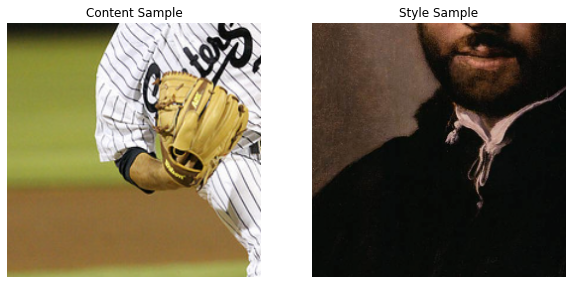

In [8]:
content_sample, _ = get_content_batch(1, crop_size, True)
style_sample, _ = get_style_batch(1, crop_size, True)

fig, ax = plt.subplots(1,2, figsize=[10,10])

ax[0].imshow((content_sample[0]+1)/2)
ax[0].axis("off")
ax[0].set_title('Content Sample')
ax[1].imshow((style_sample[0]+1)/2)
ax[1].axis("off")
ax[1].set_title('Style Sample')

In [9]:
encoder = vgg19_die().cuda()
decoder = Decoder().cuda()

optimizer = optim.Adam(decoder.parameters(), lr=learning_rate)


Pretrained Model is loaded!: ./ImageNet-master/vgg19-dcbb9e9d.pth


In [10]:
train_loader_c = iter(data_loader.data_loader_c('./train2017_sub', batch_size=8))
train_loader_s = iter(data_loader.data_loader_s('./wikiart', batch_size=8))

/usr/lib/python3/dist-packages/PIL/Image.py:2514: DecompressionBombWarning: Image size (107327830 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  DecompressionBombWarning)
/usr/lib/python3/dist-packages/PIL/TiffImagePlugin.py:739: UserWarning: Possibly corrupt EXIF data.  Expecting to read 4718592 bytes but only got 0. Skipping tag 0
  " Skipping tag %s" % (size, len(data), tag))
/usr/lib/python3/dist-packages/PIL/TiffImagePlugin.py:739: UserWarning: Possibly corrupt EXIF data.  Expecting to read 787528 bytes but only got 5533. Skipping tag 0
  " Skipping tag %s" % (size, len(data), tag))
/usr/lib/python3/dist-packages/PIL/TiffImagePlugin.py:739: UserWarning: Possibly corrupt EXIF data.  Expecting to read 7281180688 bytes but only got 0. Skipping tag 8
  " Skipping tag %s" % (size, len(data), tag))
/usr/lib/python3/dist-packages/PIL/TiffImagePlugin.py:739: UserWarning: Possibly corrupt EXIF data.  Expecting to read 787528 bytes but only got 5401. Ski

Batch: 0 / C loss: 1.5265 / S loss: 20.0253


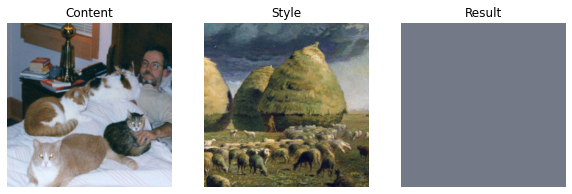

Batch: 100 / C loss: 1.8704 / S loss: 12.0042


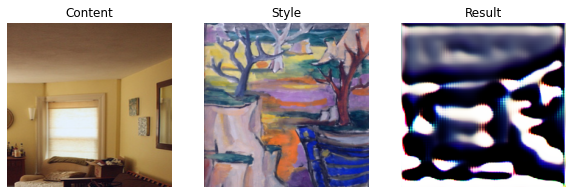

Batch: 200 / C loss: 1.8759 / S loss: 7.9672


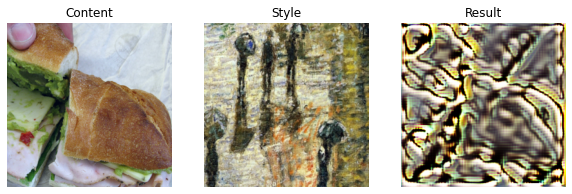

Batch: 300 / C loss: 1.8269 / S loss: 6.5364


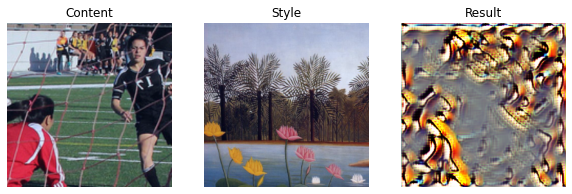

Batch: 400 / C loss: 1.8199 / S loss: 5.9849


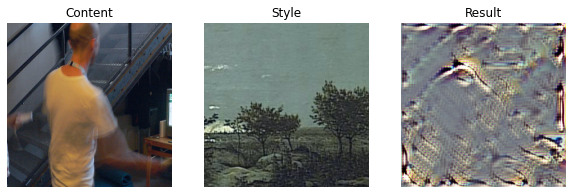

Batch: 500 / C loss: 1.7951 / S loss: 5.6621


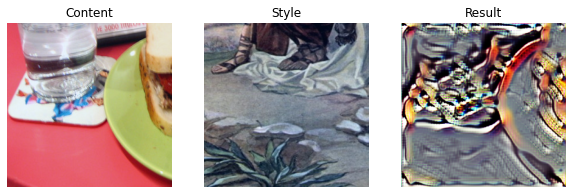

Batch: 600 / C loss: 1.7700 / S loss: 5.4355


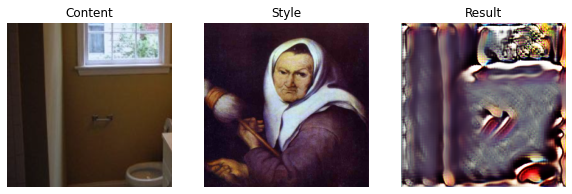

Batch: 700 / C loss: 1.7880 / S loss: 5.2434


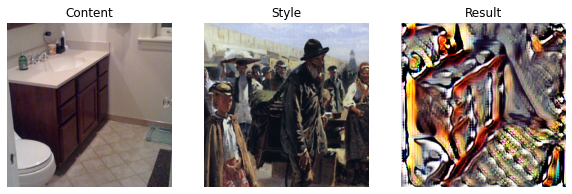

Batch: 800 / C loss: 1.7625 / S loss: 5.1576


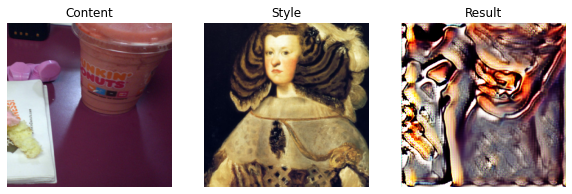

Batch: 900 / C loss: 1.7676 / S loss: 5.1271


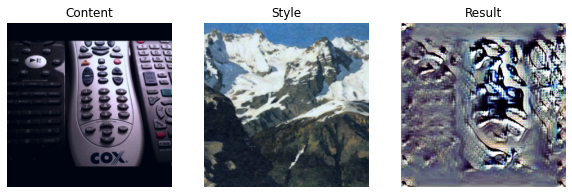

Batch: 1000 / C loss: 1.7799 / S loss: 5.0557


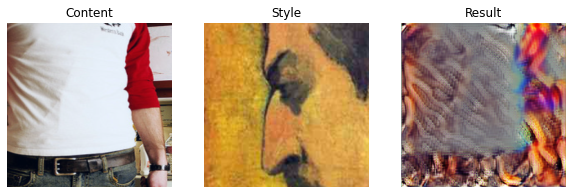

Batch: 1100 / C loss: 1.7711 / S loss: 4.9274


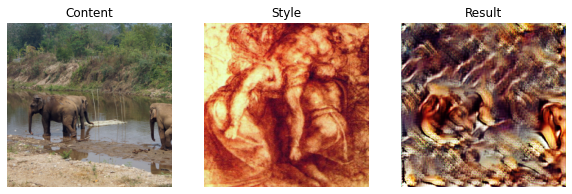

Batch: 1200 / C loss: 1.7722 / S loss: 4.9367


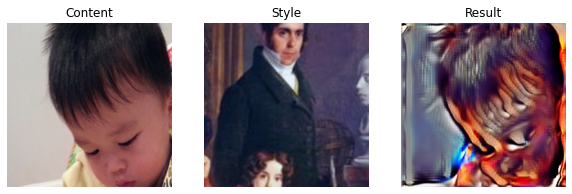

Batch: 1300 / C loss: 1.7563 / S loss: 4.8794


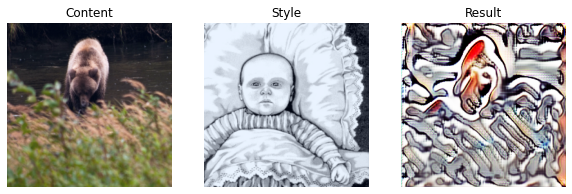

Batch: 1400 / C loss: 1.7398 / S loss: 4.7647


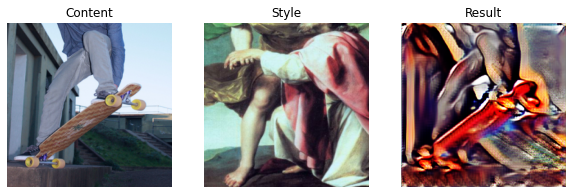

Batch: 1500 / C loss: 1.7751 / S loss: 4.8637


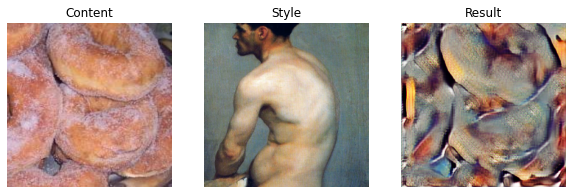

Batch: 1600 / C loss: 1.7394 / S loss: 4.6739


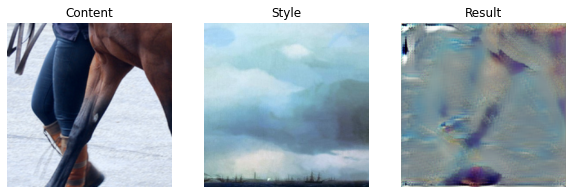

Batch: 1700 / C loss: 1.7363 / S loss: 4.6569


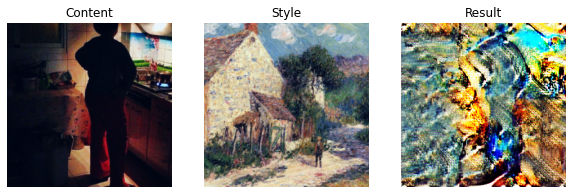

Batch: 1800 / C loss: 1.7116 / S loss: 4.5346


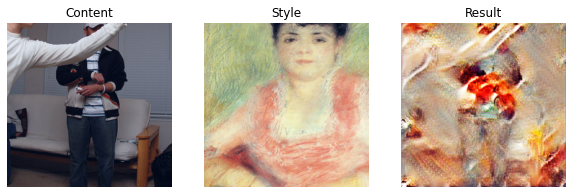

Batch: 1900 / C loss: 1.7140 / S loss: 4.4906


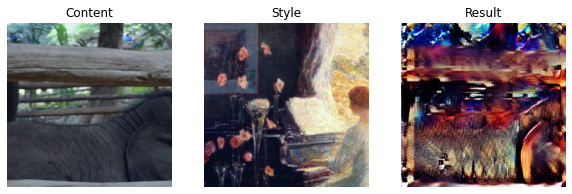

Batch: 2000 / C loss: 1.7090 / S loss: 4.5138


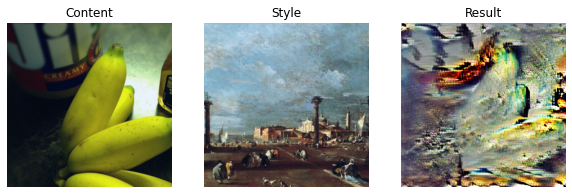

Batch: 2100 / C loss: 1.7516 / S loss: 4.5357


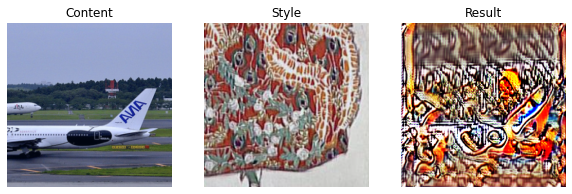

Batch: 2200 / C loss: 1.6992 / S loss: 4.4285


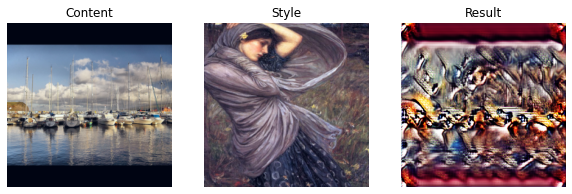

Batch: 2300 / C loss: 1.6914 / S loss: 4.4198


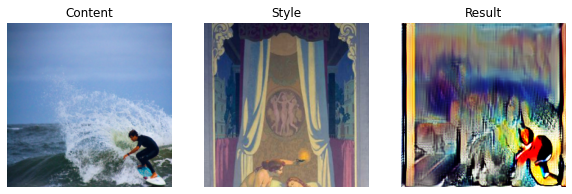

Batch: 2400 / C loss: 1.7029 / S loss: 4.4259


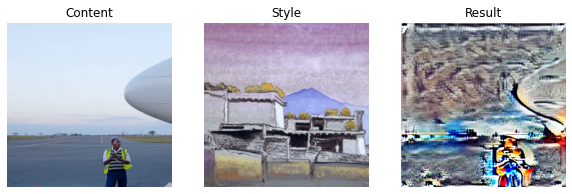

Batch: 2500 / C loss: 1.7427 / S loss: 4.4671


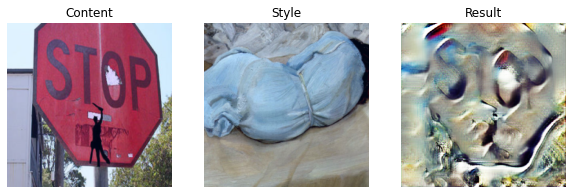

Batch: 2600 / C loss: 1.6833 / S loss: 4.2959


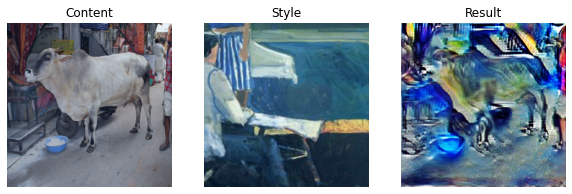

Batch: 2700 / C loss: 1.6993 / S loss: 4.3570


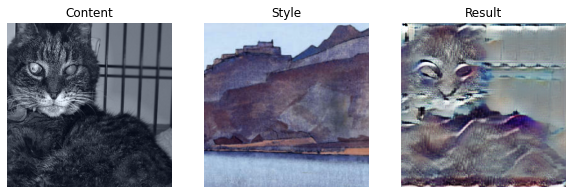

Batch: 2800 / C loss: 1.7100 / S loss: 4.2509


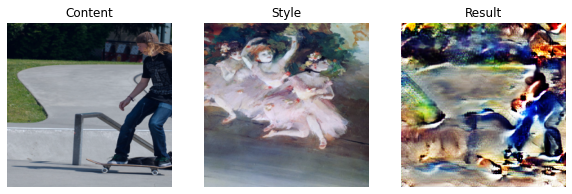

Batch: 2900 / C loss: 1.7065 / S loss: 4.2337


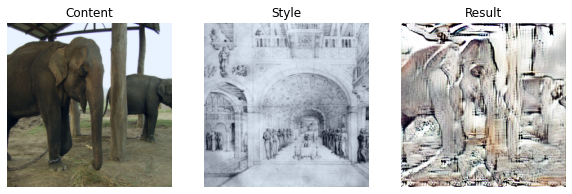

Batch: 3000 / C loss: 1.6933 / S loss: 4.2575


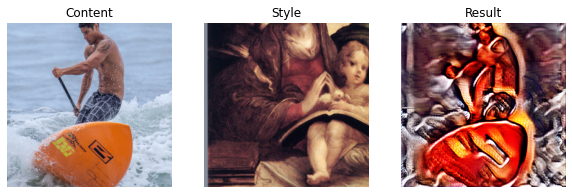

Batch: 3100 / C loss: 1.6536 / S loss: 4.1114


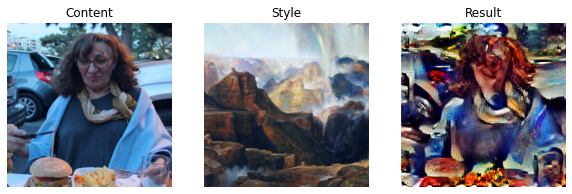

Batch: 3200 / C loss: 1.6908 / S loss: 4.2182


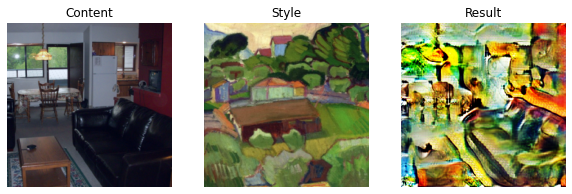

Batch: 3300 / C loss: 1.6863 / S loss: 4.1703


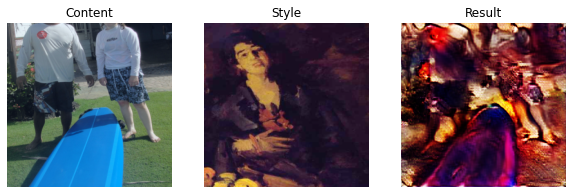

Batch: 3400 / C loss: 1.6672 / S loss: 4.2008


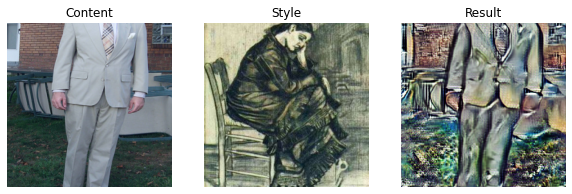

Batch: 3500 / C loss: 1.6670 / S loss: 4.1112


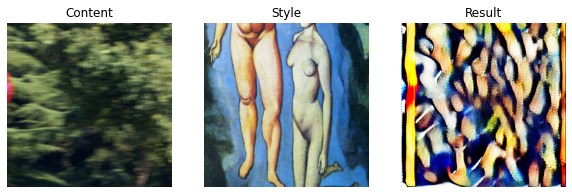

Batch: 3600 / C loss: 1.6758 / S loss: 4.1738


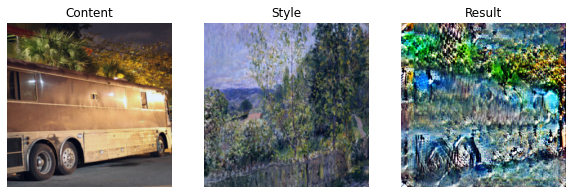

Batch: 3700 / C loss: 1.6529 / S loss: 4.1043


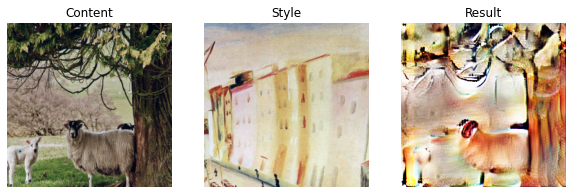

Batch: 3800 / C loss: 1.6717 / S loss: 4.1709


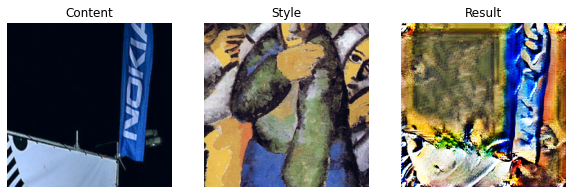

Batch: 3900 / C loss: 1.6589 / S loss: 4.0714


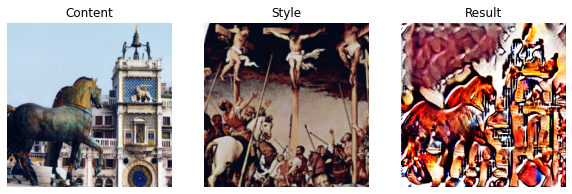

Batch: 4000 / C loss: 1.6621 / S loss: 4.1259


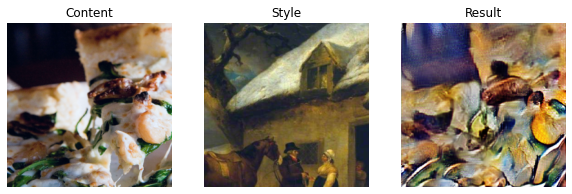

Batch: 4100 / C loss: 1.6641 / S loss: 4.0931


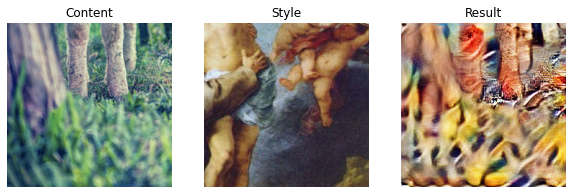

Batch: 4200 / C loss: 1.6702 / S loss: 4.0454


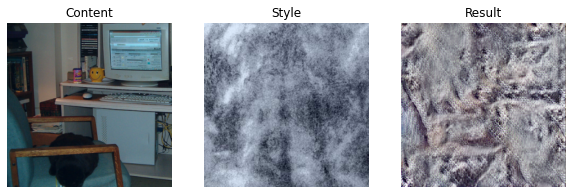

Batch: 4300 / C loss: 1.6549 / S loss: 4.0577


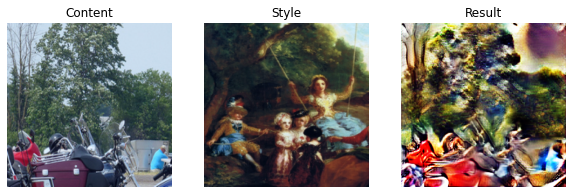

Batch: 4400 / C loss: 1.6482 / S loss: 4.0284


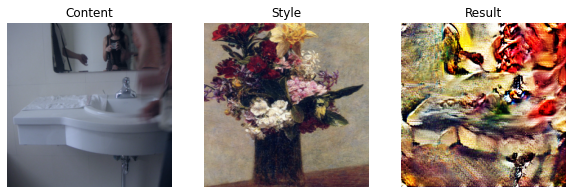

Batch: 4500 / C loss: 1.6423 / S loss: 3.9325


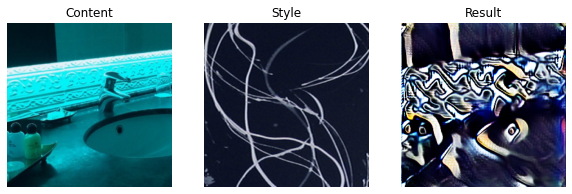

Batch: 4600 / C loss: 1.6360 / S loss: 3.9421


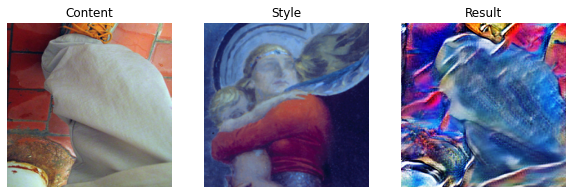

Batch: 4700 / C loss: 1.6295 / S loss: 4.0042


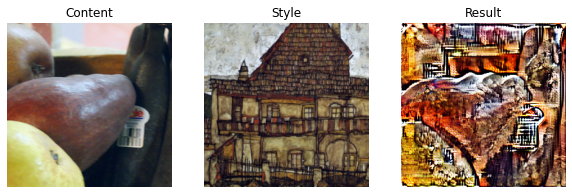

Batch: 4800 / C loss: 1.6666 / S loss: 4.0045


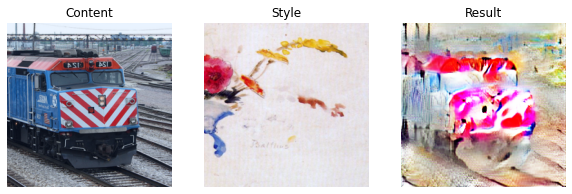

Batch: 4900 / C loss: 1.6692 / S loss: 4.0506


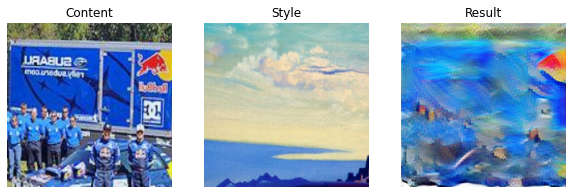

Batch: 5000 / C loss: 1.6498 / S loss: 3.9665


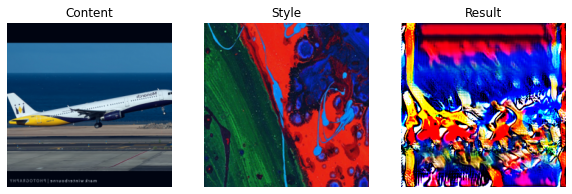

Batch: 5100 / C loss: 1.6490 / S loss: 3.8676


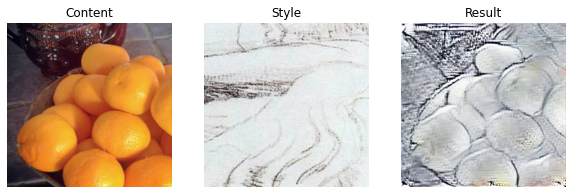

Batch: 5200 / C loss: 1.6411 / S loss: 3.9942


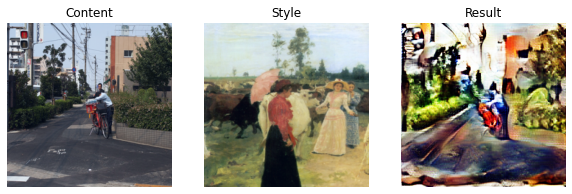

Batch: 5300 / C loss: 1.6645 / S loss: 3.9844


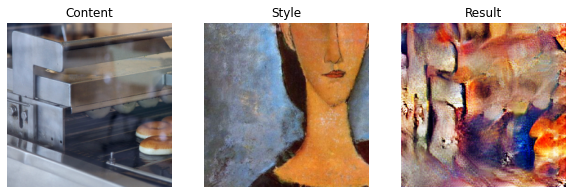

Batch: 5400 / C loss: 1.6525 / S loss: 4.0511


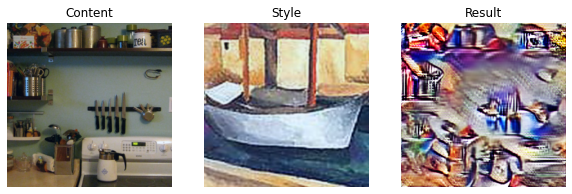

Batch: 5500 / C loss: 1.6172 / S loss: 3.8664


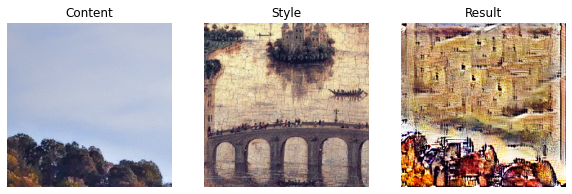

Batch: 5600 / C loss: 1.6467 / S loss: 3.9030


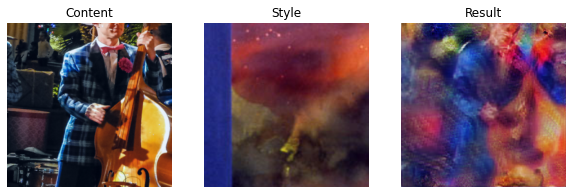

Batch: 5700 / C loss: 1.6366 / S loss: 3.9039


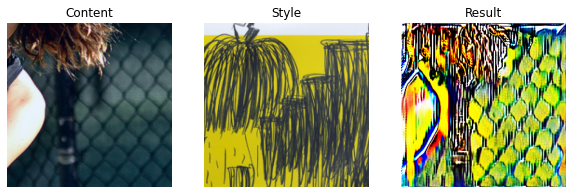

Batch: 5800 / C loss: 1.6458 / S loss: 3.9155


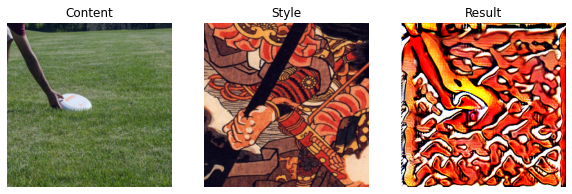

Batch: 5900 / C loss: 1.6188 / S loss: 3.9393


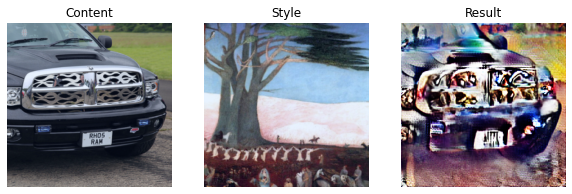

Batch: 6000 / C loss: 1.6227 / S loss: 3.8785


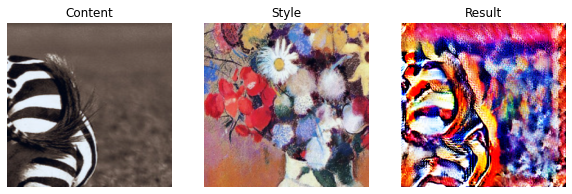

Batch: 6100 / C loss: 1.6623 / S loss: 3.9482


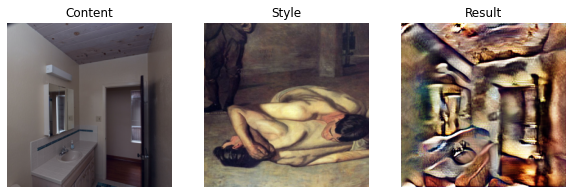

Batch: 6200 / C loss: 1.6068 / S loss: 3.8066


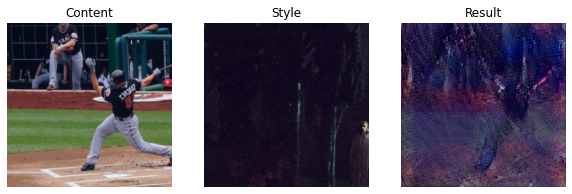

Batch: 6300 / C loss: 1.6071 / S loss: 3.8154


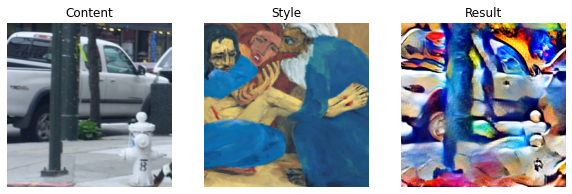

Batch: 6400 / C loss: 1.6247 / S loss: 3.9184


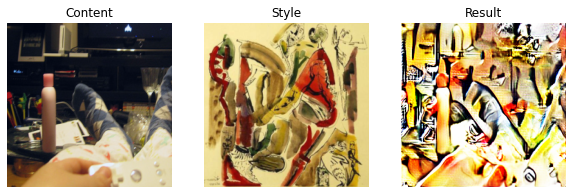

Batch: 6500 / C loss: 1.6307 / S loss: 3.8561


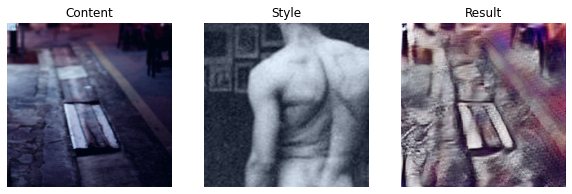

Batch: 6600 / C loss: 1.6144 / S loss: 3.8758


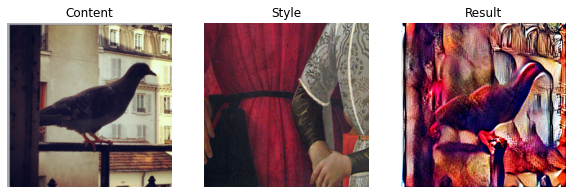

Batch: 6700 / C loss: 1.6034 / S loss: 3.7637


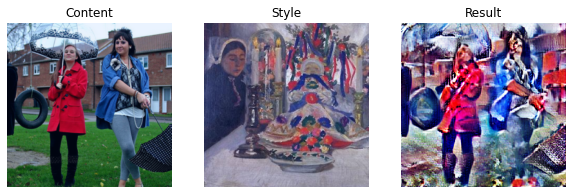

Batch: 6800 / C loss: 1.6065 / S loss: 3.8136


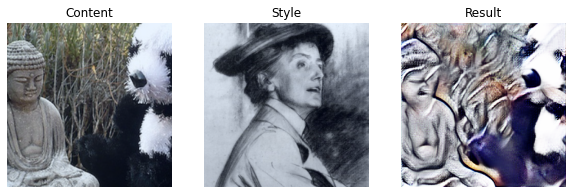

Batch: 6900 / C loss: 1.6280 / S loss: 3.8071


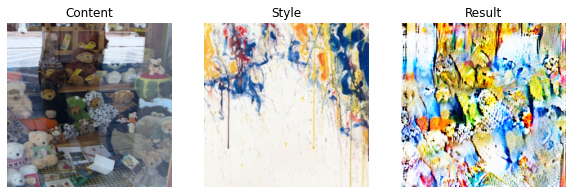

Batch: 7000 / C loss: 1.6113 / S loss: 3.7738


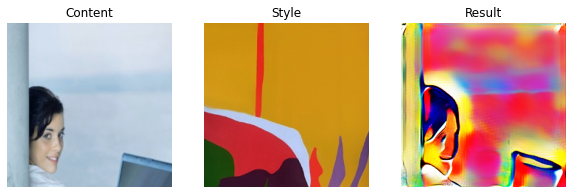

Batch: 7100 / C loss: 1.6338 / S loss: 3.8990


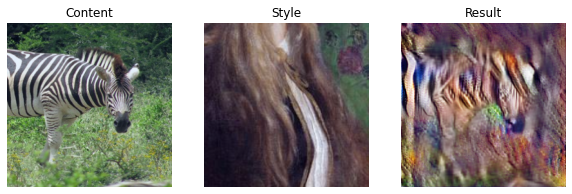

Batch: 7200 / C loss: 1.6280 / S loss: 3.8399


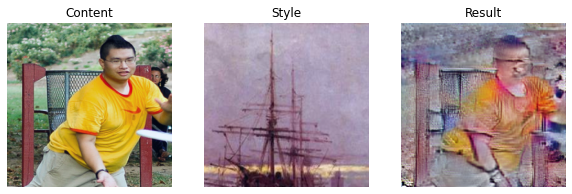

Batch: 7300 / C loss: 1.6178 / S loss: 3.8125


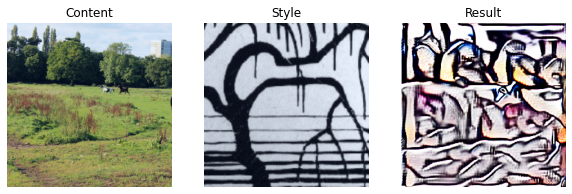

Batch: 7400 / C loss: 1.5884 / S loss: 3.7738


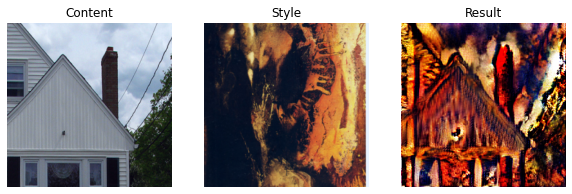

Batch: 7500 / C loss: 1.6085 / S loss: 3.7520


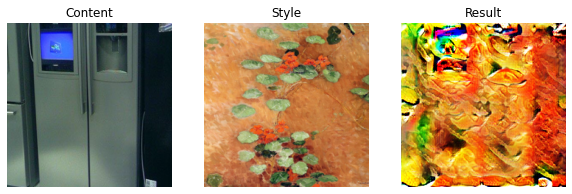

Batch: 7600 / C loss: 1.6042 / S loss: 3.7274


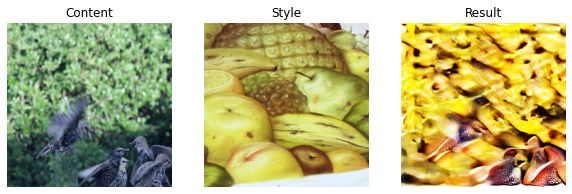

Batch: 7700 / C loss: 1.5892 / S loss: 3.6950


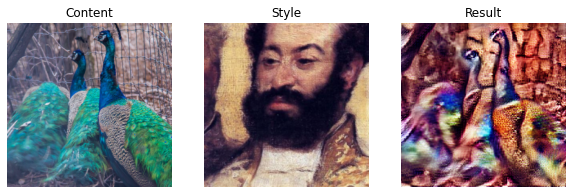

Batch: 7800 / C loss: 1.6025 / S loss: 3.7670


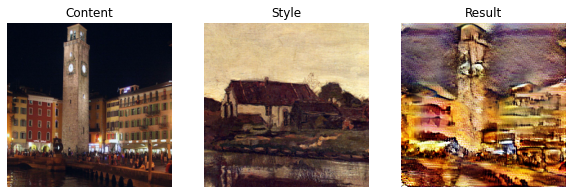

Batch: 7900 / C loss: 1.5985 / S loss: 3.7522


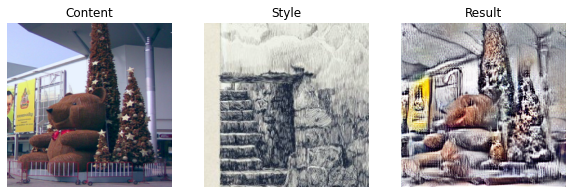

Batch: 8000 / C loss: 1.6039 / S loss: 3.7014


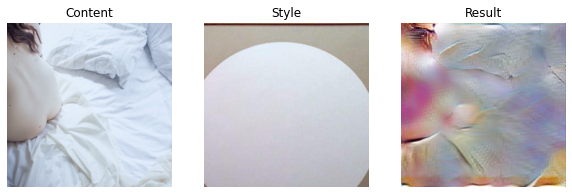

Batch: 8100 / C loss: 1.6085 / S loss: 3.8197


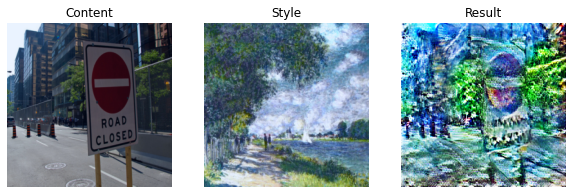

Batch: 8200 / C loss: 1.5764 / S loss: 3.6791


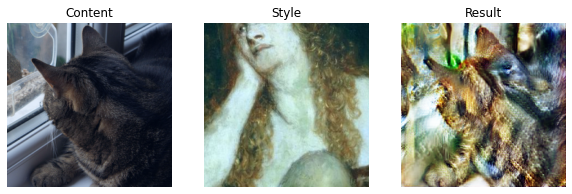

Batch: 8300 / C loss: 1.6135 / S loss: 3.8090


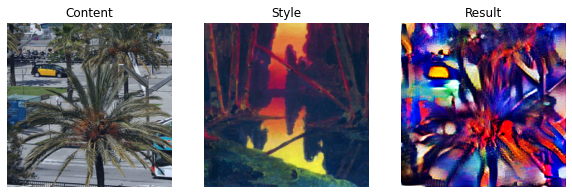

Batch: 8400 / C loss: 1.5692 / S loss: 3.6795


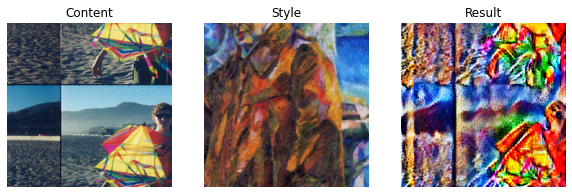

Batch: 8500 / C loss: 1.6056 / S loss: 3.7468


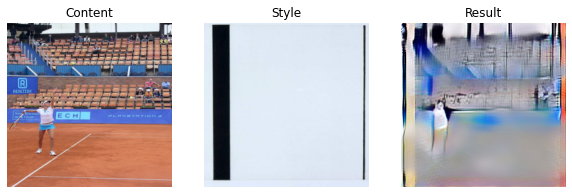

Batch: 8600 / C loss: 1.5814 / S loss: 3.6432


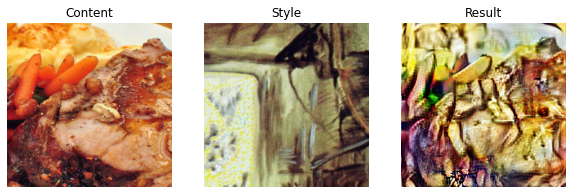

Batch: 8700 / C loss: 1.6064 / S loss: 3.7269


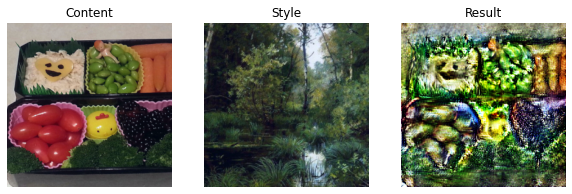

Batch: 8800 / C loss: 1.5870 / S loss: 3.7062


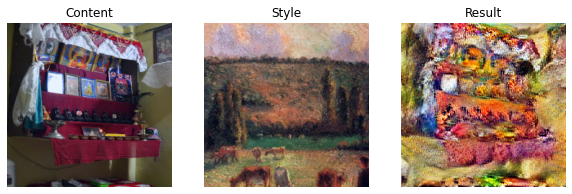

Batch: 8900 / C loss: 1.6008 / S loss: 3.7315


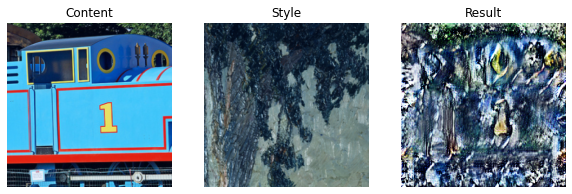

Batch: 9000 / C loss: 1.6117 / S loss: 3.7057


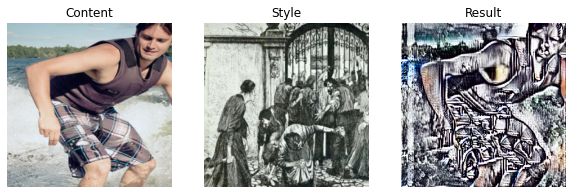

Batch: 9100 / C loss: 1.6017 / S loss: 3.7560


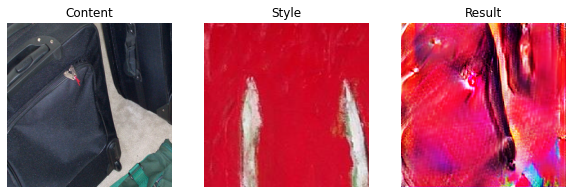

Batch: 9200 / C loss: 1.6099 / S loss: 3.7488


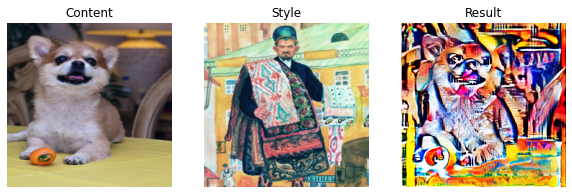

Batch: 9300 / C loss: 1.5592 / S loss: 3.5797


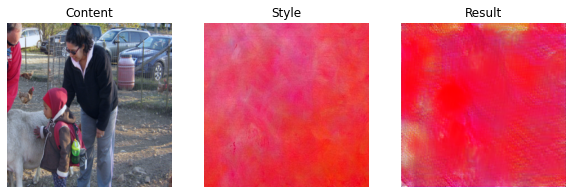

Batch: 9400 / C loss: 1.5777 / S loss: 3.6552


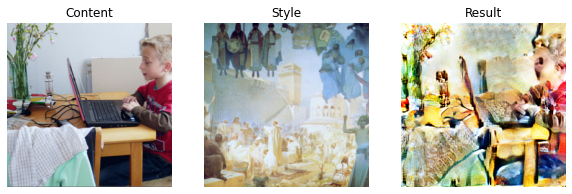

Batch: 9500 / C loss: 1.5649 / S loss: 3.5922


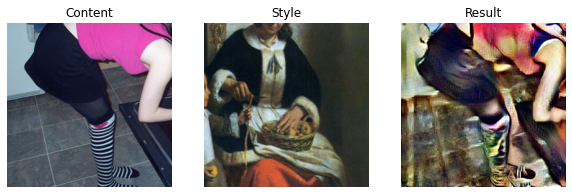

Batch: 9600 / C loss: 1.5918 / S loss: 3.6152


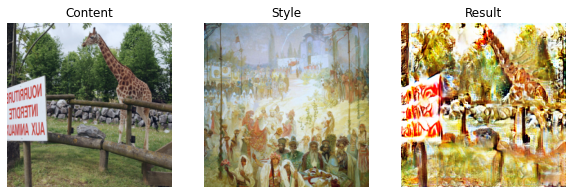

Batch: 9700 / C loss: 1.6024 / S loss: 3.7228


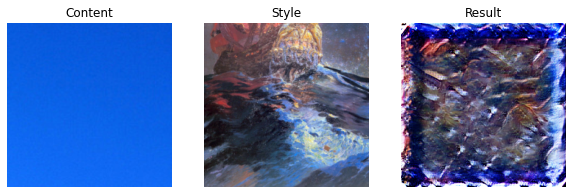

Batch: 9800 / C loss: 1.5844 / S loss: 3.6503


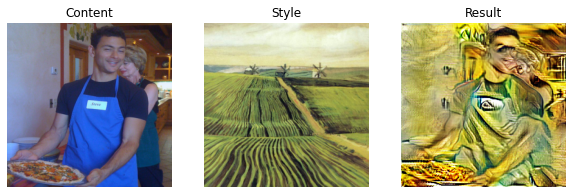

Batch: 9900 / C loss: 1.6297 / S loss: 3.7750


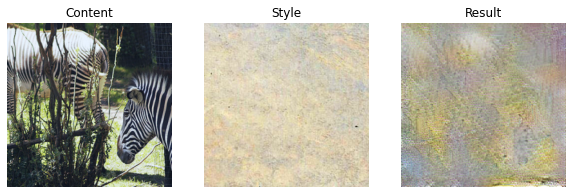

In [11]:
if train_model:
    c_loss_list = []
    s_loss_list = []
    for i in range(train_batch):
#         content_batch, content_path_ = get_content_batch(batch_size, crop_size, True)
#         style_batch, style_path_ = get_style_batch(batch_size, crop_size, True)

#         content_batch = torch.FloatTensor(np.transpose(content_batch, (0,3,1,2))).to(device)
#         style_batch = torch.FloatTensor(np.transpose(style_batch, (0,3,1,2))).to(device)
            
        content_batch = next(train_loader_c)[0].cuda()
        try:
            style_batch = next(train_loader_s)[0].cuda()
        except:
            style_batch = next(train_loader_s)[0].cuda()
    
        fc1,fc2,fc3,fc4 = encoder(content_batch)
        fs1,fs2,fs3,fs4 = encoder(style_batch)
        
        ### AdaIN
        c_mean = fc4.mean(dim=[2,3], keepdim=True)
        c_std  = fc4.std(dim=[2,3], keepdim=True) + 1e-8

        s_mean = fs4.mean(dim=[2,3], keepdim=True)
        s_std  = fs4.std(dim=[2,3], keepdim=True) + 1e-8

        normalized_c = (fc4 - c_mean)/c_std
        t = (s_std * normalized_c) + s_mean 

#         t = AdaIN(fc4, fs4)
        t_weight = ((1-alpha)*fc4) + (alpha*t)

        out_img = decoder(t_weight)

        fo1,fo2,fo3,fo4 = encoder(out_img)

        loss_c = F.l1_loss(t,fo4)

        fo_mean_list = [fo1.mean(dim=[2,3]),fo2.mean(dim=[2,3]),fo3.mean(dim=[2,3]),fo4.mean(dim=[2,3])]
        fs_mean_list = [fs1.mean(dim=[2,3]),fs2.mean(dim=[2,3]),fs3.mean(dim=[2,3]),fs4.mean(dim=[2,3])]

        fo_std_list = [fo1.std(dim=[2,3]),fo2.std(dim=[2,3]),fo3.std(dim=[2,3]),fo4.std(dim=[2,3])]
        fs_std_list = [fs1.std(dim=[2,3]),fs2.std(dim=[2,3]),fs3.std(dim=[2,3]),fs4.std(dim=[2,3])]

        loss_s = 0
        for k in range(4):
            mean_o = fo_mean_list[k]
            mean_s = fs_mean_list[k]

            std_o = fo_std_list[k]
            std_s = fs_std_list[k]

            loss_s_mean = F.l1_loss(mean_o, mean_s)
            loss_s_std  = F.l1_loss(std_o, std_s)

            loss_s += (style_weight*(loss_s_mean+loss_s_std))

        loss = loss_c + loss_s

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        c_loss_list.append(loss_c.item())
        s_loss_list.append(loss_s.item())

        print("Batch step: {} / {}".format(i, train_batch), end='\r')

        if i % show_img_step == 0:
            print("Batch: {} / C loss: {:.4f} / S loss: {:.4f}".format(i, np.mean(c_loss_list), np.mean(s_loss_list)))

            c_loss_list = []
            s_loss_list = []

            fig, ax = plt.subplots(1,3, figsize=[10,10])

            content_batch = np.transpose(content_batch.cpu().numpy(), (0,2,3,1))
            style_batch = np.transpose(style_batch.cpu().numpy(), (0,2,3,1))
            out_img = np.transpose(out_img.detach().cpu().numpy(), (0,2,3,1))
            
#             print(np.min(content_batch[0]))
#             print(np.max(content_batch[0]))
#             print(np.min((content_batch[0]-np.min(content_batch[0]))/(-np.min(content_batch[0])+np.max(content_batch[0]))))
#             print(np.max((content_batch[0]-np.min(content_batch[0]))/(-np.min(content_batch[0])+np.max(content_batch[0]))))
            
            ax[0].imshow((content_batch[0]-np.min(content_batch[0]))/(-np.min(content_batch[0])+np.max(content_batch[0])))
            ax[0].axis("off")
            ax[0].set_title('Content')
            ax[1].imshow((style_batch[0]-np.min(style_batch[0]))/(-np.min(style_batch[0])+np.max(style_batch[0])))
            ax[1].axis("off")
            ax[1].set_title('Style')
            ax[2].imshow((out_img[0]+1)/2)
            ax[2].axis("off")
            ax[2].set_title('Result')

#             ax[0].imshow((content_batch[0]+1)/2)
#             ax[0].axis("off")
#             ax[0].set_title('Content')
#             ax[1].imshow((style_batch[0]+1)/2)
#             ax[1].axis("off")
#             ax[1].set_title('Style')
#             ax[2].imshow((out_img[0]+1)/2)
#             ax[2].axis("off")
#             ax[2].set_title('Result')

            plt.show()

In [12]:
torch.save(decoder.state_dict(), './AdaIN_decoder.path')

## Test (Result)

In [13]:
decoder.load_state_dict(torch.load('./AdaIN_decoder.path'))
decoder.eval()

Decoder(
  (conv1_1): Conv2d(512, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (relu1_1): ReLU(inplace=True)
  (up1): Upsample(scale_factor=2.0, mode=nearest)
  (conv2_1): Conv2d(512, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (relu2_1): ReLU(inplace=True)
  (conv2_2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (relu2_2): ReLU(inplace=True)
  (conv2_3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (relu2_3): ReLU(inplace=True)
  (up2): Upsample(scale_factor=2.0, mode=nearest)
  (conv3_1): Conv2d(256, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (relu3_1): ReLU(inplace=True)
  (conv3_2): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (relu3_2): ReLU(inplace=True)
  (up3): Upsample(scale_factor=2.0, mode=nearest)
  (conv4_1): Conv2d(128, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (relu4_1): ReLU(inplace=True)
  (conv4_2): Conv2d(64, 64, kernel_size=(3, 3), str

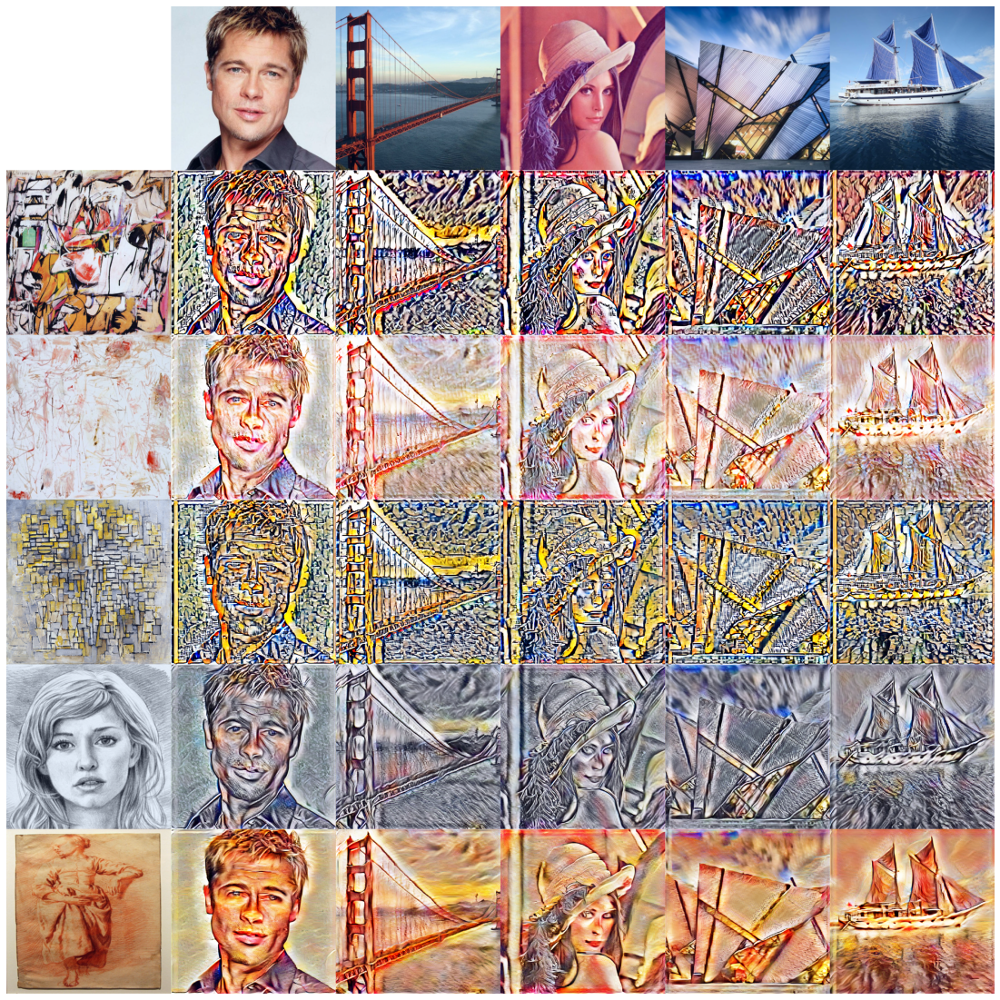

In [14]:
num_test = 5

c_test_list = [2, 6, 7, 8, 10]
s_test_list = [1, 13, 9, 14, 17]

result_img = np.ones([512*(num_test+1), 512*(num_test+1), 3])

val_loader_c = iter(data_loader.data_loader_val('./test/content',batch_size=1))
val_loader_s = iter(data_loader.data_loader_val('./test/style',batch_size=1))

c_tensor_list = []
s_tensor_list = []

for i in range(11):
    c_tensor_list.append(next(val_loader_c)[0])
    
for i in range(20):
    s_tensor_list.append(next(val_loader_s)[0])
    
for i in range(num_test):
#     test_content_sample, test_style_sample = get_test(c_test_list[i], s_test_list[i])
    c_idx = c_test_list[i]
    s_idx = s_test_list[i]
    
    test_content_sample = np.transpose(c_tensor_list[c_idx].detach().cpu().numpy(), (0,2,3,1))
    test_style_sample = np.transpose(s_tensor_list[s_idx].detach().cpu().numpy(), (0,2,3,1))
    
    result_img[0:512, (i+1)*512:(i+2)*512] = (test_content_sample[0]-np.min(test_content_sample[0]))/(-np.min(test_content_sample[0])+np.max(test_content_sample[0]))
    result_img[(i+1)*512:(i+2)*512, 0:512] = (test_style_sample[0]-np.min(test_style_sample[0]))/(-np.min(test_style_sample[0])+np.max(test_style_sample[0]))
    
for i in range(num_test**2):
    row = int(i/num_test)
    col = int(i%num_test)
    
#     test_content_sample, test_style_sample = get_test(c_test_list[col], s_test_list[row])
    
#     test_content_sample = np.expand_dims(test_content_sample, axis=0)
#     test_style_sample = np.expand_dims(test_style_sample, axis=0)
    
    with torch.no_grad():
        test_content_sample = c_tensor_list[c_test_list[col]].cuda()
        test_style_sample = s_tensor_list[s_test_list[row]].cuda()
        
#         test_content_sample = torch.FloatTensor(np.transpose(test_content_sample, (0,3,1,2))).to(device)
#         test_style_sample = torch.FloatTensor(np.transpose(test_style_sample, (0,3,1,2))).to(device)

        fc1,fc2,fc3,fc4 = encoder(test_content_sample)
        fs1,fs2,fs3,fs4 = encoder(test_style_sample)

        ### AdaIN
        c_mean = fc4.mean(dim=[2,3], keepdim=True)
        c_std  = fc4.std(dim=[2,3], keepdim=True) + 1e-8

        s_mean = fs4.mean(dim=[2,3], keepdim=True)
        s_std  = fs4.std(dim=[2,3], keepdim=True) + 1e-8

        normalized_c = (fc4 - c_mean)/c_std
        t = (s_std * normalized_c) + s_mean 

    #         t = AdaIN(fc4, fs4)
        t_weight = ((1-alpha)*fc4) + (alpha*t)

        out_img = decoder(t_weight)
        out_img = np.transpose(out_img.detach().cpu().numpy(), (0,2,3,1))

    result_img[(row+1)*512:(row+2)*512, (col+1)*512:(col+2)*512] = (out_img[0]+1)/2

plt.figure(figsize=(20,20))
plt.imshow(result_img)
plt.axis("off")
plt.show()

## Test (Interpolation)

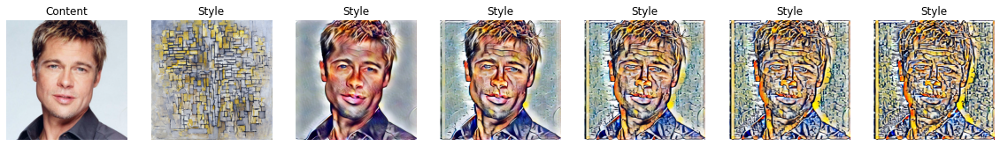

In [15]:
# test_content_sample, test_style_sample = get_test(8, 14)
test_content_sample = c_tensor_list[2].to(device)
test_style_sample = s_tensor_list[9].to(device)

fig, ax = plt.subplots(1,7, figsize=[20,20])

test_content_plt = np.transpose(c_tensor_list[2].detach().cpu().numpy(), (0,2,3,1))
test_style_plt = np.transpose(s_tensor_list[9].detach().cpu().numpy(), (0,2,3,1))

test_content_plt = (test_content_plt[0]-np.min(test_content_plt[0]))/(-np.min(test_content_plt[0])+np.max(test_content_plt[0]))
test_style_plt = (test_style_plt[0]-np.min(test_style_plt[0]))/(-np.min(test_style_plt[0])+np.max(test_style_plt[0]))

ax[0].imshow(test_content_plt)
ax[0].axis("off")
ax[0].set_title('Content')
ax[1].imshow(test_style_plt)
ax[1].axis("off")
ax[1].set_title('Style')

for i in range(5):
    alpha = i/4
    
    fc1,fc2,fc3,fc4 = encoder(test_content_sample)
    fs1,fs2,fs3,fs4 = encoder(test_style_sample)

    ### AdaIN
    c_mean = fc4.mean(dim=[2,3], keepdim=True)
    c_std  = fc4.std(dim=[2,3], keepdim=True) + 1e-8

    s_mean = fs4.mean(dim=[2,3], keepdim=True)
    s_std  = fs4.std(dim=[2,3], keepdim=True) + 1e-8

    normalized_c = (fc4 - c_mean)/c_std
    t = (s_std * normalized_c) + s_mean 

#         t = AdaIN(fc4, fs4)
    t_weight = ((1-alpha)*fc4) + (alpha*t)

    out_img = decoder(t_weight)
    out_img = np.transpose(out_img.detach().cpu().numpy(), (0,2,3,1))

    ax[2+i].imshow((out_img[0]+1)/2)
    ax[2+i].axis("off")
    ax[2+i].set_title('Style')

## Save Model